# Protein abundance change

This notebook runs the analyses on protein abundance changes between variant and reference alleles using Cell Painting assays

In [42]:
### imports
import os
import polars as pl
import numpy as np
from tqdm import tqdm
from pathlib import Path
import matplotlib.pyplot as plt
import seaborn as sns
from plot_utils import *
%matplotlib inline

PLATEMAP_DIR = "../../../1_inputs/1_snakemake_pipeline/inputs/metadata/platemaps/{batch_id}/platemap"
PROF_DIR = "../../../3_outputs/1_snakemake_pipeline/2.sm_pipeline_outputs/batch_profiles"
CLASS_RES_DIR = "../../../3_outputs/1_snakemake_pipeline/2.sm_pipeline_outputs/classification_results"

## Disable truncation globally
# TRN_IMBAL_THRES = 3
# MIN_CLASS_NUM = 2
# pl.Config.set_tbl_rows(20)  # Show all rows
# pl.Config.set_tbl_cols(40)  # Show all columns

In [43]:
BIO_REP_BATCHES = ["2025_01_27_Batch_13", "2025_01_28_Batch_14"]
COMBINED_BIO_REP_DIR = "2025_01_Batch_13-14"

IMG_QC_DIR = f"../../../3_outputs/1_snakemake_pipeline/1.image_well_qc_results/{COMBINED_BIO_REP_DIR}"
OUTPUT_DIR = f"../../../3_outputs/1_snakemake_pipeline/pipeline_results_analyses/2.cell_count_abundance_change/{COMBINED_BIO_REP_DIR}"
if not os.path.exists(OUTPUT_DIR):
    os.makedirs(OUTPUT_DIR)

## 1. Load Metadata

### 1.1 Meta allele data

In [44]:
batch_id = BIO_REP_BATCHES[0]
allele_meta_df = pl.DataFrame()

for platemap in os.listdir(PLATEMAP_DIR.format(batch_id=batch_id)):
    platemap_df = pl.read_csv(os.path.join(PLATEMAP_DIR.format(batch_id=batch_id), platemap), separator="\t", infer_schema_length=100000)
    allele_meta_df = pl.concat([allele_meta_df, platemap_df], how="diagonal_relaxed")

allele_meta_df.filter((pl.col("gene_allele").is_not_null())&(pl.col("node_type")=="allele")).unique(subset=["gene_allele"])
tested_variants = allele_meta_df.filter((pl.col("gene_allele").is_not_null())&(pl.col("node_type")=="allele")).unique(subset=["gene_allele"])["gene_allele"]

clin_var_annot_df = pl.read_csv("../../../../../1_allele_collection/1_inputs/varchamp_consolidated_alleles_clinvar_gnomad_dbnsfp_scores.tsv", separator="\t", infer_schema_length=10000)
allele_meta_df = allele_meta_df.join(
    clin_var_annot_df.with_columns(
        pl.concat_str([pl.col("symbol"), pl.col("aa_change")], separator="_").alias("gene_allele")
    ),
    on="gene_allele",
    how="left"
)
allele_meta_df

plate_map_name,well_position,symbol,gene_allele,imaging_well,imaging_plate_R1,imaging_plate_R2,node_type,orf_id_wt,ccsb_mutation_id,nt_change_cdna,aa_change,allele_set,imaging_plate,batch1,batch2,clone_ID,hgmd_ID,clinvar_allele_ID,clinvar_clinical_significance,vector,notes,plate,quad,c96,r96,r384,c384,r384_letter,orf_id,symbol_right,nt_change,aa_change_right,ensembl_gene_id,chr,chr_pos_38,spdi,…,RS# (dbSNP)_dbnsfp,nsv/esv (dbVar)_dbnsfp,RCVaccession_dbnsfp,PhenotypeIDS_dbnsfp,PhenotypeList_dbnsfp,Origin_dbnsfp,OriginSimple_dbnsfp,Assembly_dbnsfp,ChromosomeAccession_dbnsfp,Chromosome_dbnsfp,Start_dbnsfp,Stop_dbnsfp,Cytogenetic_dbnsfp,ReviewStatus_dbnsfp,NumberSubmitters_dbnsfp,Guidelines_dbnsfp,TestedInGTR_dbnsfp,OtherIDs_dbnsfp,SubmitterCategories_dbnsfp,VariationID_dbnsfp,PositionVCF_dbnsfp,ReferenceAlleleVCF_dbnsfp,AlternateAlleleVCF_dbnsfp,SomaticClinicalImpact_dbnsfp,SomaticClinicalImpactLastEvaluated_dbnsfp,ReviewStatusClinicalImpact_dbnsfp,Oncogenicity_dbnsfp,OncogenicityLastEvaluated_dbnsfp,ReviewStatusOncogenicity_dbnsfp,SCVsForAggregateGermlineClassification_dbnsfp,SCVsForAggregateSomaticClinicalImpact_dbnsfp,SCVsForAggregateOncogenicityClassification_dbnsfp,clinvar_nt_change_dbnsfp,clinvar_aa_change_dbnsfp,RefSeq_mRNA_dbnsfp,StarStatus_dbnsfp,clinvar_clnsig_clean_dbnsfp
str,str,str,str,str,str,str,str,f64,str,str,str,f64,f64,f64,f64,str,str,str,str,f64,str,i64,i64,i64,i64,i64,i64,str,i64,str,str,str,str,str,i64,str,…,i64,str,str,str,str,str,str,str,str,str,i64,i64,str,str,i64,str,str,str,i64,i64,i64,str,str,str,str,str,str,str,str,str,str,str,str,str,str,i64,str
"""B13A7A8P1_R1""","""A01""","""ABCD1""","""ABCD1""","""A01""","""B13A7A8P1_R1""","""B14A7A8P1_R2""","""disease_wt""",1.00008637e8,null,null,null,7.0,1.0,13.0,14.0,null,null,null,null,527.0,null,1,1,1,1,1,1,"""A""",null,null,null,null,null,null,null,null,…,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
"""B13A7A8P1_R1""","""C01""","""ABCD1""","""ABCD1_Arg518Trp""","""C01""","""B13A7A8P1_R1""","""B14A7A8P1_R2""","""allele""",1.00008637e8,"""CCSBVarC007022""","""1552C>T""","""Arg518Trp""",7.0,1.0,13.0,14.0,null,null,null,null,527.0,null,1,1,1,2,3,1,"""C""",100008637,"""ABCD1""","""1552C>T""","""Arg518Trp""","""ENSG00000101986""","""X""",153740155,"""NC_000023.11:153740155:C:T""",…,128624224,"""-""","""RCV000012059|RCV001358358|RCV0…","""MONDO:MONDO:0018544,MedGen:C01…","""Adrenoleukodystrophy|X-linked …","""germline;unknown""","""germline""","""GRCh38""","""NC_000023.11""","""X""",153740155,153740155,"""Xq28""","""criteria provided, multiple su…",9,"""-""","""N""","""ClinGen:CA278115,UniProtKB:P33…",3,11307,153740155,"""C""","""T""","""-""","""-""","""-""","""-""","""-""","""-""","""SCV000109783|SCV000918373|SCV0…","""-""","""-""","""1552C>T ""","""Arg518Trp""","""NM_000033.4""",2,"""1_Pathogenic"""
"""B13A7A8P1_R1""","""E01""","""ABCD1""","""ABCD1_Arg389Gly""","""E01""","""B13A7A8P1_R1""","""B14A7A8P1_R2""","""allele""",1.00008637e8,"""CCSBVarC007023""","""1165C>G""","""Arg389Gly""",7.0,1.0,13.0,14.0,null,null,null,null,527.0,null,1,1,1,3,5,1,"""E""",100008637,"""ABCD1""","""1165C>G""","""Arg389Gly""","""ENSG00000101986""","""X""",153736195,"""NC_000023.11:153736195:C:G""",…,128624215,"""-""","""RCV000012048|RCV003488335""","""MONDO:MONDO:0018544,MedGen:C01…","""Adrenoleukodystrophy|not provi…","""germline""","""germline""","""GRCh38""","""NC_000023.11""","""X""",153736195,153736195,"""Xq28""","""criteria provided, multiple su…",3,"""-""","""N""","""ClinGen:CA278102,UniProtKB:P33…",3,11296,153736195,"""C""","""G""","""-""","""-""","""-""","""-""","""-""","""-""","""SCV000932772|SCV004238662""","""-""","""-""","""1165C>G ""","""Arg389Gly""","""NM_000033.4""",2,"""1_Pathogenic"""
"""B13A7A8P1_R1""","""G01""","""ABCD1""","""ABCD1_Arg518Gln""","""G01""","""B13A7A8P1_R1""","""B14A7A8P1_R2""","""allele""",1.00008637e8,"""CCSBVarC0

### 1.2 Get the comparable REF-VAR pairs

The cell counts between Ref. and Var. alleles should be comparable (using a TRN_IMBAL_THRES = 3).

In [45]:
# Paths
# metrics_dir = "{}/{}/profiles_tcdropped_filtered_var_mad_outlier_featselect_filtcells"

# metrics_df, metrics_wtvar = pl.DataFrame(), pl.DataFrame()
# for batch in BIO_REP_BATCHES:
#     met_dir = metrics_dir.format(CLASS_RES_DIR, batch)
#     metrics_df_batch = pl.read_csv(f"{met_dir}/metrics.csv")
#     metrics_df = pl.concat([metrics_df, metrics_df_batch])
    # metrics_wtvar_batch = pl.read_csv(f"{met_dir}/metrics_summary.csv")
    # metrics_wtvar = pl.concat([metrics_wtvar, metrics_wtvar_batch])

## get individual classifiers pass the training imbalance threshold
# balanced_classifiers = metrics_df.filter(
#     (~pl.col("Metadata_Control"))
#     & (pl.col("Training_imbalance") < TRN_IMBAL_THRES)
#     & (
#         (pl.col("Full_Classifier_ID").str.contains("true")) ## protein_localization detection
#     )
# )

# balanced_class_alleles = balanced_classifiers.select(pl.col("allele_0","allele_1")).unique().to_numpy()
# balanced_class_alleles = np.unique(balanced_class_alleles.flatten())
# len(balanced_class_alleles)

## 2. CellProfiler Features

### Get the CP features for cells that passed the QC

In [46]:
pass_qc_prof_dir = "{}/{}/profiles_tcdropped_filtered_var_mad_outlier_featselect_filtcells.parquet"
cell_alleles = pl.DataFrame()

for batch_id in BIO_REP_BATCHES:
    # Get meta features
    batch_alleles = (
        pl.scan_parquet(
            pass_qc_prof_dir.format(PROF_DIR, batch_id)
        )
        # .filter(pl.col("Metadata_gene_allele").is_in(all_alleles))
        .with_columns(
            pl.concat_str(
                [
                    "Metadata_Plate",
                    "Metadata_Well",
                    "Metadata_ImageNumber",
                    "Metadata_ObjectNumber",
                ],
                separator="_",
            ).alias("Metadata_CellID")
        )
        .select([
            "Metadata_CellID",
            "Metadata_gene_allele",
            "Metadata_Well",
            "Metadata_Plate",
        ])
    )
    cell_alleles = pl.concat([cell_alleles, batch_alleles.collect()])

### Get the Cells_Intensity CP features per all cells

Merge the Cells_Intensity features to the pass-QC cells

In [47]:
combined_gfp_profiles = pl.DataFrame()
for batch_id in BIO_REP_BATCHES:
    # Get meta features
    batch_gfp_prof = (
        pl.scan_parquet(
            f"{PROF_DIR}/{batch_id}/profiles.parquet"
        ).with_columns(
            pl.concat_str(
                [
                    "Metadata_Plate",
                    "Metadata_Well",
                    "Metadata_ImageNumber",
                    "Metadata_ObjectNumber",
                ],
                separator="_",
            ).alias("Metadata_CellID")
        )
    )
    gfp_int = [i for i in batch_gfp_prof.collect_schema().names() if "Cells_Intensity" in i]
    gfp_int = ["Metadata_CellID"] + [i for i in gfp_int if "GFP" in i]

    combined_gfp_profiles = pl.concat([
        combined_gfp_profiles, 
        batch_gfp_prof.select(gfp_int).collect()
    ])

profiles = cell_alleles.join(combined_gfp_profiles, on="Metadata_CellID", how="left")

### Aggregate the cells to well profiles

In [48]:
well_profiles = (
    profiles.group_by(["Metadata_Plate", "Metadata_Well", "Metadata_gene_allele"])
    .agg(
        pl.col(col).median().alias(col)
        for col in profiles.columns
        if not col.startswith("Metadata_")
    )
    # .filter(pl.col("Metadata_gene_allele").is_in(balanced_class_alleles))
    .unique()
)

img_well_qc_sum = pl.read_csv(f"{IMG_QC_DIR}/plate-well-level_img_qc_sum.csv")
img_well_qc_sum_gfp = img_well_qc_sum.filter(pl.col("channel")=="GFP").with_columns(
    pl.col("plate").alias("Metadata_Plate"),
    pl.col("well").alias("Metadata_Well"),
)

well_profiles = well_profiles.join(
    img_well_qc_sum_gfp,
    on=["Metadata_Plate","Metadata_Well"],
    how="left"
)
print("Original image wells:", well_profiles.shape)

Original image wells: (5539, 72)


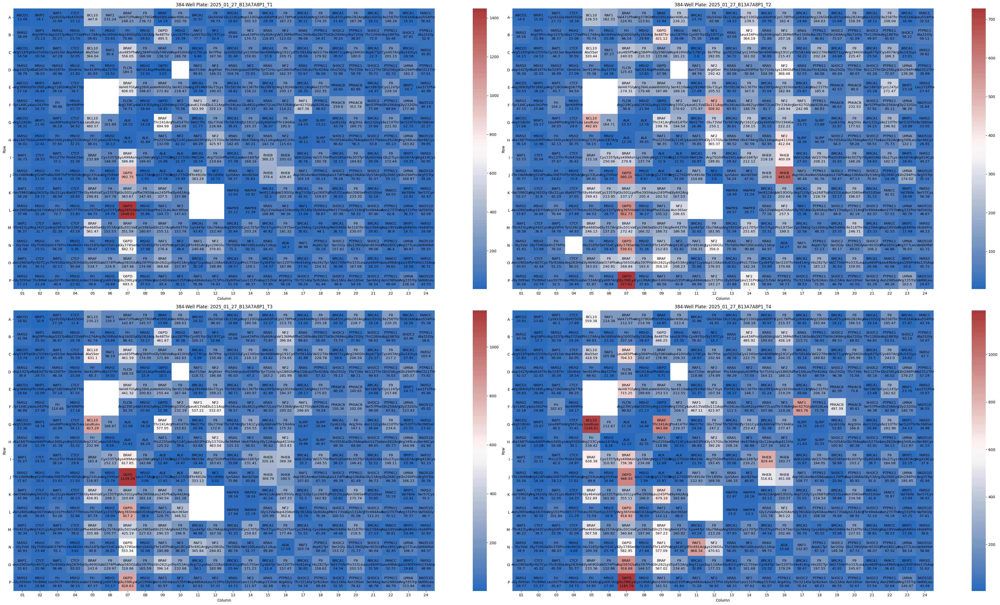

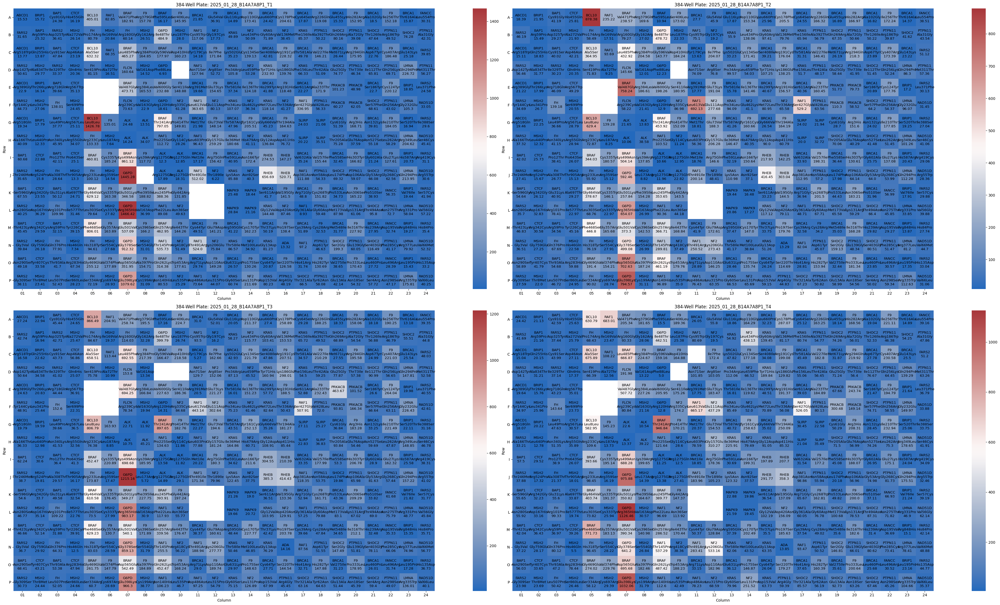

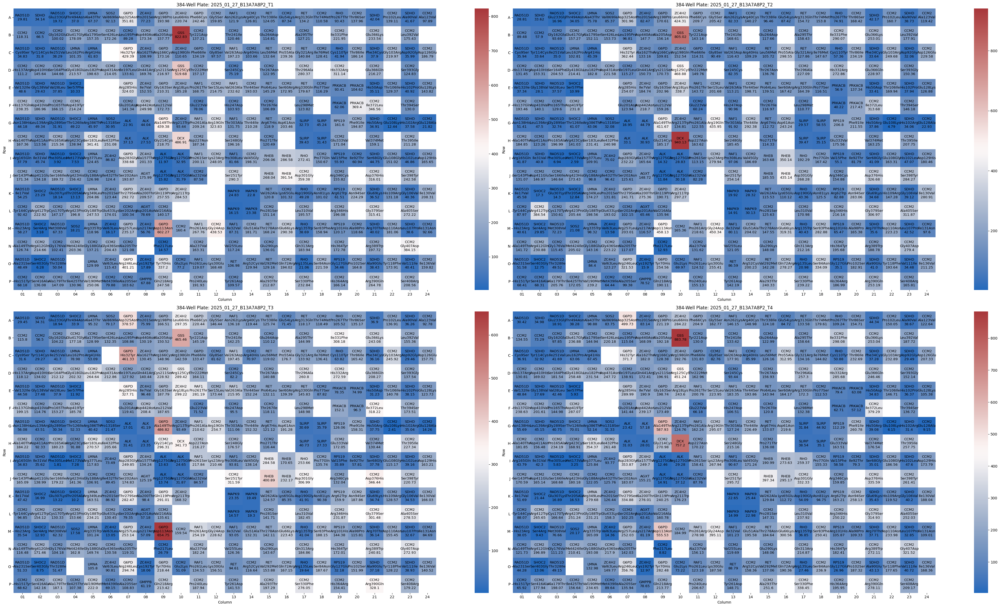

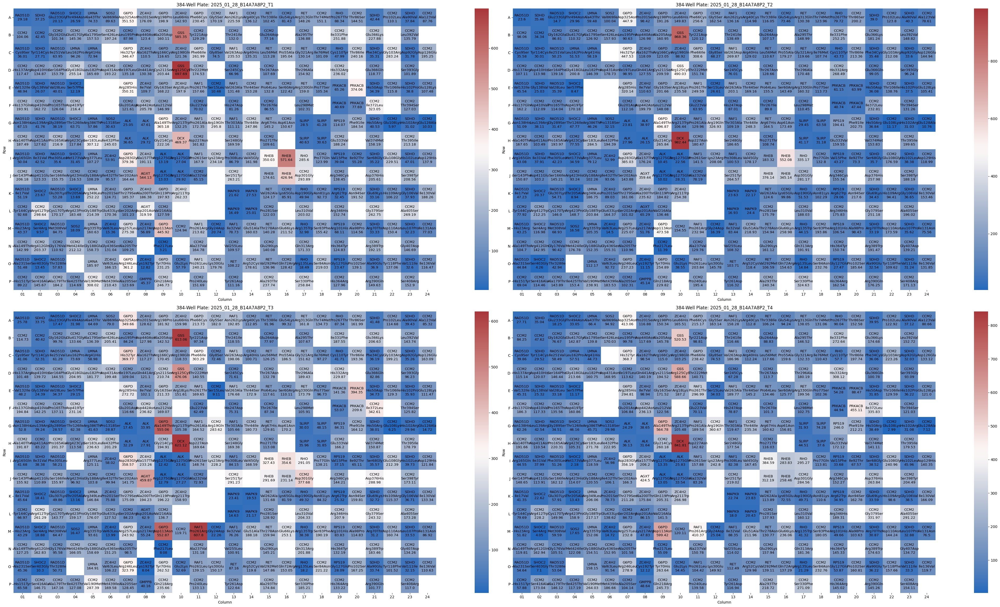

In [15]:
def plot_gfp_per_plate(well_profile_df, gfp_feat="Cells_Intensity_IntegratedIntensity_GFP"):
    plate_maps = set(["_".join(plate_map.split("_")[:-1]) for plate_map in sorted(well_profile_df["Metadata_Plate"].unique())])
    for plate_map in plate_maps:
        plate_map_cc = well_profile_df.filter(pl.col("Metadata_Plate").str.contains(plate_map))
        plates = sorted(plate_map_cc["Metadata_Plate"].unique().to_list())
        fig, axes = plt.subplots(2,2,figsize=(48,23)) ## sharey=True,sharex=True
        for plate in plates:
            plate_info = plate_map_cc.filter(pl.col("Metadata_Plate")==plate)
            # display(plate_info.filter(pl.col("is_bg")))
            # print(plates.index(plate))
            plot_platemap(
                plate_info,
                plate,
                well_pos_col="Metadata_Well",
                # this is the column to color by (categorical or continuous)
                value_col=gfp_feat,
                # these columns will be concatenated into the annotation text
                label_cols=("Metadata_gene_allele",gfp_feat),
                ax=axes[plates.index(plate)//2, plates.index(plate)%2],
                value_type="continuous",   # or "continuous"
                continuous_cmap="vlag",  # matplotlib colormap for continuous mode
                grid_square=None
            )
        fig.subplots_adjust(wspace=-.55, hspace=.05)
        plt.tight_layout()
        plt.show()

plot_gfp_per_plate(well_profiles)

In [49]:
well_profiles = well_profiles.filter(~pl.col("is_bg"))
print("Image wells after QC based on DAPI:", well_profiles.shape)

Image wells after QC based on DAPI: (5363, 72)


## 3. Calculate abundance hits

Use paired t-test to call abundance hits

In [50]:
from scipy.stats import shapiro
import re
from scipy.stats import wilcoxon
from scipy.stats import ttest_rel
import pandas as pd

GFP_FEAT = "Cells_Intensity_IntegratedIntensity_GFP"

# Convert letter rows to numbers
def well_to_coordinates(well):
    row_letter, col_number = re.match(r"([A-P])(\d{2})", well).groups()
    row_index = ord(row_letter) - ord('A') + 1  # Convert 'A'->1, 'B'->2, ..., 'P'->16
    col_index = int(col_number)  # Convert string column to integer
    return well, row_index, col_index


# Compute distances from edges and find the most centered well
def compute_distance(row, col):
    return min(row - 1, 16 - row, col - 1, 24 - col)  # Distance from nearest edge


## Abundance recalculation test: by Cell MeanIntensity
def paired_ttest(dat, reference: str, var: str, intensity_type: str=GFP_FEAT):
    # pivot to wide: one row per plate
    wide_gfp = dat.pivot(index="Metadata_Plate",
                        columns="Metadata_gene_allele",
                        values=intensity_type)
    # drop any plate that doesn’t have both measurements
    wide_gfp = wide_gfp.dropna(subset=[reference, var])
    if wide_gfp.shape[0] >= 3:
        # now run paired t-test
        t_stat, p_val = ttest_rel(wide_gfp[reference], wide_gfp[var])
    else:
        t_stat, p_val = None, None

    # ## perform stat test
    # dat = dat.dropna().sort_values(["Metadata_Plate","Metadata_gene_allele"])
    # # Assuming well_abun_stats is a DataFrame with columns 'reference_abundance' and 'variant_abundance'
    # reference_abundance = dat[dat["Metadata_gene_allele"]==reference][intensity_type].values
    # variant_abundance = dat[dat["Metadata_gene_allele"]==var][intensity_type].values
    # t_stat, p_val = ttest_rel(variant_abundance, reference_abundance)
    
    # Calculate Cohen's d
    mean_diff = np.mean(wide_gfp[var]) - np.mean(wide_gfp[reference])
    pooled_std = np.sqrt((np.std(wide_gfp[var], ddof=1) ** 2 + np.std(wide_gfp[reference], ddof=1) ** 2) / 2)
    cohen_d = mean_diff / pooled_std

    summary_df = pl.DataFrame(
        {
            "t_stat": t_stat,
            "p_val": p_val,
            "cohen_d": cohen_d
        }
    )
    summary_df = summary_df.with_columns(
        pl.lit(reference).alias("Gene"), pl.lit(var).alias("Variant")
    )
    return summary_df

In [51]:
well_abun_stats = []

for allele in tqdm(well_profiles.select(pl.col("Metadata_gene_allele")).to_pandas()["Metadata_gene_allele"].unique()):
    if allele is None or allele.split("_")[0] == allele or allele not in tested_variants:
        continue

    reference = allele.split("_")[0]
    temp_prof = well_profiles.filter(
        (pl.col("Metadata_gene_allele") == allele) | (pl.col("Metadata_gene_allele") == reference)
    ).select(
        pl.col(["Metadata_gene_allele","Metadata_Plate","Metadata_Well",GFP_FEAT])
    ).to_pandas()
    
    if (temp_prof["Metadata_gene_allele"].unique().shape[0] < 2):
        # print(temp_prof)
        continue

    var_profiles = temp_prof[temp_prof["Metadata_gene_allele"]==allele]
    ref_profiles = temp_prof[(temp_prof["Metadata_gene_allele"]==reference)&(temp_prof["Metadata_Plate"].isin(var_profiles["Metadata_Plate"].unique()))]
    temp_prof = pd.concat([var_profiles, ref_profiles])

    ref_wells = ref_profiles["Metadata_Well"].unique()
    var_wells = var_profiles["Metadata_Well"].unique()
    ref_var_pairs = [(ref_well, var_well) for ref_well in ref_wells for var_well in var_wells]
    # display(temp_prof)
    
    ## Per each ref-var well pair on the SAME plate, train and test the classifier
    for ref_var in ref_var_pairs:
        ## sort the wells to make sure they are from the same plate
        df_sampled = temp_prof[temp_prof["Metadata_Well"].isin(ref_var)].dropna().sort_values(["Metadata_Plate","Metadata_gene_allele"])
        # display(df_sampled)
        paired_t_res = paired_ttest(
            dat=df_sampled,
            reference=reference,
            var=allele
        ).with_columns(
            pl.lit(ref_var[0]).alias("Ref_well"),
            pl.lit(ref_var[1]).alias("Var_well")
        )
        well_abun_stats.append(
            paired_t_res
        )

well_abun_stats = pl.concat(well_abun_stats, how="vertical")
well_abun_stats = well_abun_stats.rename({"t_stat": "U2OS_t"})
well_abun_stats = well_abun_stats.sort(["Gene", "Variant", "U2OS_t", "p_val", "cohen_d"])
well_abun_stats

100%|██████████| 613/613 [00:05<00:00, 120.97it/s]


U2OS_t,p_val,cohen_d,Gene,Variant,Ref_well,Var_well
f64,f64,f64,str,str,str,str
-1.732321,0.12682,0.895831,"""ABCD1""","""ABCD1_Arg389Gly""","""A01""","""E01"""
-0.280926,0.786889,0.128877,"""ABCD1""","""ABCD1_Arg518Gln""","""A01""","""G01"""
2.977011,0.020602,-1.245734,"""ABCD1""","""ABCD1_Arg518Trp""","""A01""","""C01"""
5.199516,0.001254,-2.788946,"""BAP1""","""BAP1_Arg59Pro""","""I01""","""M03"""
8.249538,0.000075,-4.305963,"""BAP1""","""BAP1_Arg59Pro""","""I01""","""B02"""
…,…,…,…,…,…,…
0.467365,0.654438,-0.175715,"""ZC4H2""","""ZC4H2_Lys217Arg""","""I06""","""M08"""
-5.151696,0.001322,1.761938,"""ZC4H2""","""ZC4H2_Pro201Ser""","""I06""","""K06"""
-2.164444,0.067166,1.337576,"""ZC4H2""","""ZC4H2_Pro201Ser""","""I06""","""A08"""


## 3. Summarize Results

In [52]:
## drop the null alleles
well_abun_stats = well_abun_stats.drop_nulls(subset="U2OS_t")

## extract the alleles with only single appearance
variants_single = well_abun_stats.group_by("Variant").len().filter(pl.col("len")==1)["Variant"]
well_abun_stats_single = well_abun_stats.filter(pl.col("Variant").is_in(variants_single))

## extract the alleles with replicates
variants_replicate = well_abun_stats.group_by("Variant").len().filter(pl.col("len")>1).unique(subset="Variant")["Variant"]
well_abun_stats_rep = well_abun_stats.filter(pl.col("Variant").is_in(variants_replicate))

## check the consistency between replicates
well_abun_stats_rep_group = well_abun_stats_rep.group_by("Variant").agg(
    pl.len().alias("count"),
    (pl.col("U2OS_t")>0).sum().alias("desc"),
    (pl.col("U2OS_t")<0).sum().alias("incr")
)
inconsistent_alleles = well_abun_stats_rep_group.filter((pl.col("count")!=pl.col("desc"))&(pl.col("count")!=pl.col("incr")))["Variant"].unique()
display(well_abun_stats_rep_group.filter((pl.col("count")!=pl.col("desc"))&(pl.col("count")!=pl.col("incr"))))

## No problem them merge by mean
well_abun_stats_rep = well_abun_stats_rep.group_by(["Gene","Variant"]).agg(
    pl.col("U2OS_t").mean().alias("U2OS_t"),
    pl.col("p_val").mean().alias("p_val")
).with_columns(
    pl.when(pl.col("Variant").is_in(inconsistent_alleles))
    .then(pl.lit(1))
    .otherwise(pl.col("p_val"))
    .alias("manual_adj_pval")
)

Variant,count,desc,incr
str,u32,u32,u32
"""CCM2_Ser202Arg""",3,2,1
"""CCM2_Ser60Arg""",3,1,2
"""SDHD_Ala90Glu""",2,1,1
"""CCM2_Lys65Glu""",3,2,1
"""CCM2_Thr106Ile""",3,1,2
…,…,…,…
"""FARS2_His135Asp""",2,1,1
"""SDHD_Ala90Val""",2,1,1
"""CCM2_Leu195Pro""",3,2,1


In [89]:
well_abun_stats_final = pl.concat([
    well_abun_stats_rep,
    well_abun_stats_single.with_columns(
        pl.col("p_val").alias("manual_adj_pval")
    ).select(pl.col(well_abun_stats_rep.columns))
])

well_abun_stats_final = well_abun_stats_final.rename({"U2OS_t": "U2OS_paired_t_stat", "manual_adj_pval": "U2OS_t_pval"})
well_abun_stats_final = well_abun_stats_final.select(["Gene", "Variant", "U2OS_paired_t_stat", "U2OS_t_pval"]) ## , "U2OS_paired_tstat_edgedist_resid", "U2OS_t_edgedist_resid_pval",

In [92]:
# Total number of increase vs. decrease
total = well_abun_stats_final.shape[0]

## We are comparing REF - VAR in the paired_ttest ttest_rel
## The t-statistic is calculated as np.mean(a - b)/se, where se is the standard error.
## Thus, t-stat > 0 means REF more than VAR --> VAR decreasing CC
per_dec = well_abun_stats_final.filter(pl.col("U2OS_paired_t_stat") > 0).shape[0]
per_inc = well_abun_stats_final.filter(pl.col("U2OS_paired_t_stat") < 0).shape[0]

print("Total decreasin vs increasing percent:")
print(f"{per_dec} {per_dec / total * 100:.2f} %")
print(f"{per_inc} {per_inc / total * 100:.2f} %")

dec_sig = well_abun_stats_final.filter(pl.col("U2OS_t_pval") < 0.05).filter(pl.col("U2OS_paired_t_stat") > 0).shape[0]
inc_sig = well_abun_stats_final.filter(pl.col("U2OS_t_pval") < 0.05).filter(pl.col("U2OS_paired_t_stat") < 0).shape[0]

print("Number sig decreases")
print(dec_sig)
print("Number sig increases")
print(inc_sig)

Total decreasin vs increasing percent:
133 28.24 %
338 71.76 %
Number sig decreases
64
Number sig increases
203


In [94]:
well_abun_stats_final.sort(by="U2OS_paired_t_stat", descending=True)

Gene,Variant,U2OS_paired_t_stat,U2OS_t_pval
str,str,f64,f64
"""RAD51D""","""RAD51D_Glu233Gly""",22.260535,9.3341e-8
"""RHO""","""RHO_Arg135Leu""",16.565868,7.1324e-7
"""RHO""","""RHO_Asp190Gly""",16.309158,7.9368e-7
"""RHO""","""RHO_Arg135Trp""",16.193593,8.3324e-7
"""FLCN""","""FLCN_Arg239Cys""",15.695201,0.000001
…,…,…,…
"""RAD51D""","""RAD51D_Thr328Ile""",-18.30789,3.5923e-7
"""CCM2""","""CCM2_Asp442Asn""",-18.341956,0.000059
"""CCM2""","""CCM2_Ser248Gly""",-19.452905,0.000059


In [95]:
well_abun_stats_final.write_csv(f"{OUTPUT_DIR}/well-level_prot-abundance_changes.csv")

### 3.1 ClinVar analysis

In [59]:
well_abun_stats_final_clinvar = well_abun_stats_final.join(
    allele_meta_df.select(pl.col(["gene_allele","clinvar_clnsig_clean_dbnsfp"])), 
    left_on="Variant",
    right_on="gene_allele",
    how="inner"
).to_pandas()
well_abun_stats_final_clinvar.fillna(value={"clinvar_clnsig_clean_dbnsfp": "5_Unknown"})

,Gene,Variant,U2OS_t,p_val,manual_adj_pval,clinvar_clnsig_clean_dbnsfp
0,ABCD1,ABCD1_Arg518Trp,2.977011,0.020602,0.020602,1_Pathogenic
1,ABCD1,ABCD1_Arg389Gly,-1.732321,0.126820,0.126820,1_Pathogenic
2,ABCD1,ABCD1_Arg518Gln,-0.280926,0.786889,0.786889,1_Pathogenic
3,BAP1,BAP1_Ser596Gly,-0.876786,0.409682,0.409682,5_Unknown
4,BAP1,BAP1_Thr423Lys,4.239050,0.003845,0.003845,5_Unknown
...,...,...,...,...,...,...
480,CCM2,CCM2_Gly436Ser,-6.012965,0.020386,0.020386,5_Unknown
481,CCM2,CCM2_Met439Ile,-1.163184,0.315621,1.000000,5_Unknown
482,CCM2,CCM2_Asp440Asn,-8.095812,0.048125,1.000000,5_Unknown
483,CCM2,CCM2_Gln441Arg,-13.187428,0.147890,1.000000,5_Unknown


<Figure size 640x480 with 0 Axes>

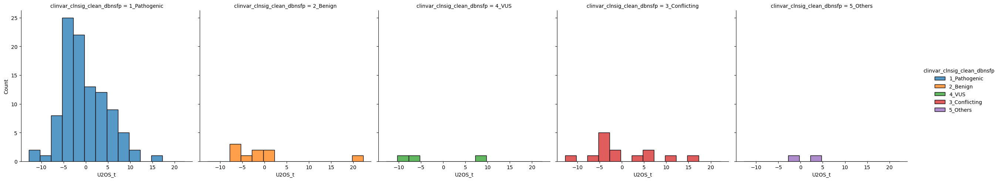

In [61]:
import seaborn as sns
import matplotlib.pyplot as plt

plt.clf()
sns.displot(
    data=well_abun_stats_final_clinvar,
    x="U2OS_t",
    hue="clinvar_clnsig_clean_dbnsfp",
    col="clinvar_clnsig_clean_dbnsfp"
)
plt.show()

## 4. Visualize Imaging Wells

In [81]:
import sys
from skimage.io import imread
sys.path.append("../../../2_analyses/1_snakemake_pipeline/2025_varchamp_snakemake/1.image_preprocess_qc/scripts/")
from img_utils import *

TIFF_IMGS_DIR = "../../../2_analyses/1_snakemake_pipeline/2025_varchamp_snakemake/1.image_preprocess_qc/inputs/cpg_imgs"
OUT_IMGS_DIR = ""

def plot_allele(pm, variant, sel_channel, plate_img_qc, site="05", ref_well=[], var_well=[], max_intensity=0.99, display=False, imgs_dir=TIFF_IMGS_DIR, output_dir=OUT_IMGS_DIR):
    plt.clf()
    cmap = channel_to_cmap(sel_channel)
    channel = channel_dict[sel_channel]
    
    ## get the number of wells/images per allele
    plate_map = pm.filter(pl.col("gene_allele") == variant).select("plate_map_name").to_pandas().values.flatten()
    wt = variant.split("_")[0]
    wt_wells = pm.filter(pl.col("gene_allele") == wt).select("imaging_well").to_pandas().values.flatten()
    var_wells = pm.filter(pl.col("gene_allele") == variant).select("imaging_well").to_pandas().values.flatten()
    if ref_well:
        wt_wells = [well for well in wt_wells if well in ref_well]
    if var_well:
        var_wells = [well for well in var_wells if well in var_well]
    
    # if len(wt_wells) > 1:
    #     # Get coordinates of wells
    #     well_coords = [well_to_coordinates(w) for w in set([ref_well_pl for ref_well_pl in wt_wells])]
    #     # Sort wells by max distance from edges (descending)
    #     wt_wells = [max(well_coords, key=lambda x: compute_distance(x[1], x[2]))[0]]
    pm_var = pm.filter((pl.col("imaging_well").is_in(np.concatenate([wt_wells, var_wells])))&(pl.col("plate_map_name").is_in(plate_map))).sort("node_type")

    fig, axes = plt.subplots((len(wt_wells)+len(var_wells))*2, 4, figsize=(15, (len(wt_wells)+len(var_wells))*8), sharex=True, sharey=True)
    for wt_var, pm_row in enumerate(pm_var.iter_rows(named=True)):
        if "allele" in pm_row["node_type"]:
            if pm_row["node_type"] == "allele":
                well = var_wells[0]
                allele = variant
            else:
                well = wt_wells[0]
                allele = wt
        else:
            if pm_row["imaging_well"] in wt_wells:
                well = wt_wells[0]
                allele = wt
            else:
                well = var_wells[0]
                allele = variant

        for i in range(8):
            if i < 4:
                sel_plate = pm_row["imaging_plate_R1"]
            else:
                sel_plate = pm_row["imaging_plate_R2"]
                
            if "_" in sel_plate:
                batch_plate_map = sel_plate.split("_")[0]
            else:
                batch_plate_map = sel_plate
            
            batch = batch_dict[batch_plate_map]
            batch_img_dir = f'{imgs_dir}/{batch}/images'
            
            letter = well[0]
            row = letter_dict[letter]
            col = well[1:3]
            
            plate_img_dir = plate_dict[sel_plate][f"T{i%4+1}"]
            img_file = f"r{row}c{col}f{site}p01-ch{channel}sk1fk1fl1.tiff"

            # print(batch, well, plate_img_dir, img_file)
            # break

            if plate_img_qc is not None:
                is_bg = plate_img_qc.filter(
                    (pl.col("plate")==plate_img_dir.split("__")[0]) & \
                    (pl.col("well")==well) & (pl.col("channel")==sel_channel))["is_bg"].to_numpy()[0]
            else:
                is_bg = False
                
            if (os.path.exists(f"{batch_img_dir}/{plate_img_dir}/Images/{img_file}")):
                img = imread(f"{batch_img_dir}/{plate_img_dir}/Images/{img_file}", as_gray=True)
            else:
                # Define your S3 path and local destination
                s3_path = f's3://cellpainting-gallery/cpg0020-varchamp/broad/images/{batch}/images/{plate_img_dir}/Images/{img_file}'
                local_path = f"{batch_img_dir}/{plate_img_dir}/Images/{img_file}"
                # Build the aws cli command
                cmd = ['aws', 's3', 'cp', '--no-sign-request', s3_path, local_path]
                # Execute the command using subprocess
                try:
                    subprocess.run(cmd, check=True)
                    print(f"Successfully downloaded from {s3_path} to {local_path}")
                except subprocess.CalledProcessError as e:
                    print(f"An error occurred: {e}")
                img = imread(f"{batch_img_dir}/{plate_img_dir}/Images/{img_file}", as_gray=True)
            
            plot_idx = i+wt_var*4*2
            # print(i, wt_var, plot_idx)
            axes.flatten()[plot_idx].imshow(img, vmin=0, vmax=np.percentile(img, max_intensity*100), cmap=cmap)
            plot_label = f"{sel_channel}:{sel_plate},T{i%4+1}\nWell:{well},Site:{site}\n{allele}"
            axes.flatten()[plot_idx].text(0.03, 0.97, plot_label, color='white', fontsize=10,
                    verticalalignment='top', horizontalalignment='left', transform=axes.flatten()[plot_idx].transAxes,
                    bbox=dict(facecolor='black', alpha=0.3, linewidth=2))
            if is_bg:
                axes.flatten()[plot_idx].text(0.03, 0.03, "FLAG:\nOnly Background\nNoise is Detected", color='red', fontsize=10,
                    verticalalignment='bottom', horizontalalignment='left', transform=axes.flatten()[plot_idx].transAxes,
                    bbox=dict(facecolor='white', alpha=0.3, linewidth=2))
            int_95 = str(int(round(np.percentile(img, 95))))
            axes.flatten()[plot_idx].text(0.97, 0.03, f"95th Intensity:{int_95}\nSet vmax:{max_intensity*100:.0f}th perc.", color='white', fontsize=10,
                           verticalalignment='bottom', horizontalalignment='right', transform=axes.flatten()[plot_idx].transAxes,
                           bbox=dict(facecolor='black', alpha=0.3, linewidth=2))
            axes.flatten()[plot_idx].axis("off")
        
    plt.tight_layout()
    plt.subplots_adjust(wspace=.01, hspace=-0.2, top=.99)
    
    if display:
        plt.show()
    if output_dir:
        fig.savefig(os.path.join(output_dir, f"{variant}_{sel_channel}.png"), dpi=400, bbox_inches='tight')
        plt.close(fig)

In [82]:
img_well_qc_sum_gfp.filter(pl.col("well")=="F24")

plate,well,channel,mean,std,perc_25,perc_50,perc_75,perc_80,perc_90,perc_95,perc_99,mean_plate,std_plate,perc_25_plate,median_plate,perc_75_plate,perc_80_plate,perc_90_plate,perc_95_plate,perc_99_plate,s2n_ratio,s2n_threshold,is_bg,plate_id,plate_well,plate_map_name,well_position,symbol,gene_allele,imaging_well,imaging_plate_R1,imaging_plate_R2,node_type,orf_id_wt,ccsb_mutation_id,nt_change_cdna,aa_change,allele_set,imaging_plate,batch1,batch2,clone_ID,hgmd_ID,clinvar_allele_ID,clinvar_clinical_significance,vector,notes,quad,c96,r96,r384,c384,r384_letter,Metadata_Plate,Metadata_Well
str,str,str,f64,f64,i64,i64,i64,i64,i64,i64,i64,f64,f64,i64,i64,i64,i64,i64,i64,i64,f64,f64,bool,str,str,str,str,str,str,str,str,str,str,f64,str,str,str,f64,f64,f64,f64,str,str,str,str,f64,str,i64,i64,i64,i64,i64,str,str,str
"""2025_01_27_B13A7A8P1_T1""","""F24""","""GFP""",349.033741,1160.538953,145,164,215,288,561,943,2729,555.861492,2895.96853,150,170,197,220,535,1389,7989,1.274638,0.18607,false,"""B13A7A8P1""","""B13A7A8P1-F24""","""B13A7A8P1_R1""","""F24""","""RAD51D""","""RAD51D""","""F24""","""B13A7A8P1_R1""","""B14A7A8P1_R2""","""disease_wt""",7201.0,null,null,null,7.0,1.0,13.0,14.0,null,null,null,null,527.0,null,4,12,3,6,24,"""F""","""2025_01_27_B13A7A8P1_T1""","""F24"""
"""2025_01_27_B13A7A8P1_T2""","""F24""","""GFP""",273.588489,967.501507,140,157,176,193,390,631,1905,630.625733,3048.468836,151,172,211,262,745,1809,9409,1.13377,0.184745,false,"""B13A7A8P1""","""B13A7A8P1-F24""","""B13A7A8P1_R1""","""F24""","""RAD51D""","""RAD51D""","""F24""","""B13A7A8P1_R1""","""B14A7A8P1_R2""","""disease_wt""",7201.0,null,null,null,7.0,1.0,13.0,14.0,null,null,null,null,527.0,null,4,12,3,6,24,"""F""","""2025_01_27_B13A7A8P1_T2""","""F24"""
"""2025_01_27_B13A7A8P1_T3""","""F24""","""GFP""",347.994006,1547.095042,141,158,177,191,416,777,4117,534.432693,2866.942786,148,166,189,204,480,1272,7706,1.465363,0.183628,false,"""B13A7A8P1""","""B13A7A8P1-F24""","""B13A7A8P1_R1""","""F24""","""RAD51D""","""RAD51D""","""F24""","""B13A7A8P1_R1""","""B14A7A8P1_R2""","""disease_wt""",7201.0,null,null,null,7.0,1.0,13.0,14.0,null,null,null,null,527.0,null,4,12,3,6,24,"""F""","""2025_01_27_B13A7A8P1_T3""","""F24"""
"""2025_01_27_B13A7A8P1_T4""","""F24""","""GFP""",332.168671,1223.015119,148,168,239,301,536,849,2403,578.298608,3064.646236,149,169,198,224,554,1420,8496,1.210495,0.187358,false,"""B13A7A8P1""","""B13A7A8P1-F24""","""B13A7A8P1_R1""","""F24""","""RAD51D""","""RAD51D""","""F24""","""B13A7A8P1_R1""","""B14A7A8P1_R2""","""disease_wt""",7201.0,null,null,null,7.0,1.0,13.0,14.0,null,null,null,null,527.0,null,4,12,3,6,24,"""F""","""2025_01_27_B13A7A8P1_T4""","""F24"""
"""2025_01_28_B14A7A8P1_T1""","""F24""","""GFP""",280.25712,883.882272,144,162,192,253,460,711,1751,483.770231,2620.860905,149,168,191,204,403,1081,6535,1.084927,0.185011,false,"""B14A7A8P1""","""B14A7A8P1-F24""","""B14A7A8P1_R2""","""F24""","""RAD51D""","""RAD51D""","""F24""","""B13A7A8P1_R1""","""B14A7A8P1_R2""","""disease_wt""",7201.0,null,null,null,7.0,1.0,13.0,14.0,null,null,null,null,527.0,null,4,12,3,6,24,"""F""","""2025_01_28_B14A7A8P1_T1""","""F24"""
"""2025_01_28_B14A7A8P1_T2""","""F24""","""GFP""",318.71265,1262.961717,146,166,240,296,512,780,2001,560.248418,2855.98529,149,169,202,235,588,1447,8039,1.136897,0.185994,false,"""B14A7A8P1""","""B14A7A8P1-F24""","""B14A7A8P1_R2""","""F24""","""RAD51D""","""RAD51D""","""F24""","""B13A7A8P1_R1""","""B14A7A8P1_R2""","""disease_wt""",7201.0,null,null,null,7.0,1.0,13.0,14.0,null,null,null,null,527.0,null,4,12,3,6,24,"""F""","""2025_01_28_B14A7A8P1_T2""","""F24"""
"""2025_01_28_B14A7A8P1_T3""","""F24""","""GFP""",353.167254,1430.630695,144,162,198,272,550,911,2802,567.346404,3059.260466,148,167,195,220,528,1344,8299,1.289108,0.185944,false,"""B14A7A8P1""","""B14A7A8P1-F24""","""B14A7A8P1_R2""","""F24""","""RAD51D""","""RAD51D""","""F24""","""B13A7A8P1_R1""","""B14A7A8P1_R2""","""disease_wt""",7201.0,null,null,null,7.0,1.0,13.0,14.0,null,null,null,null,52

<Figure size 640x480 with 0 Axes>

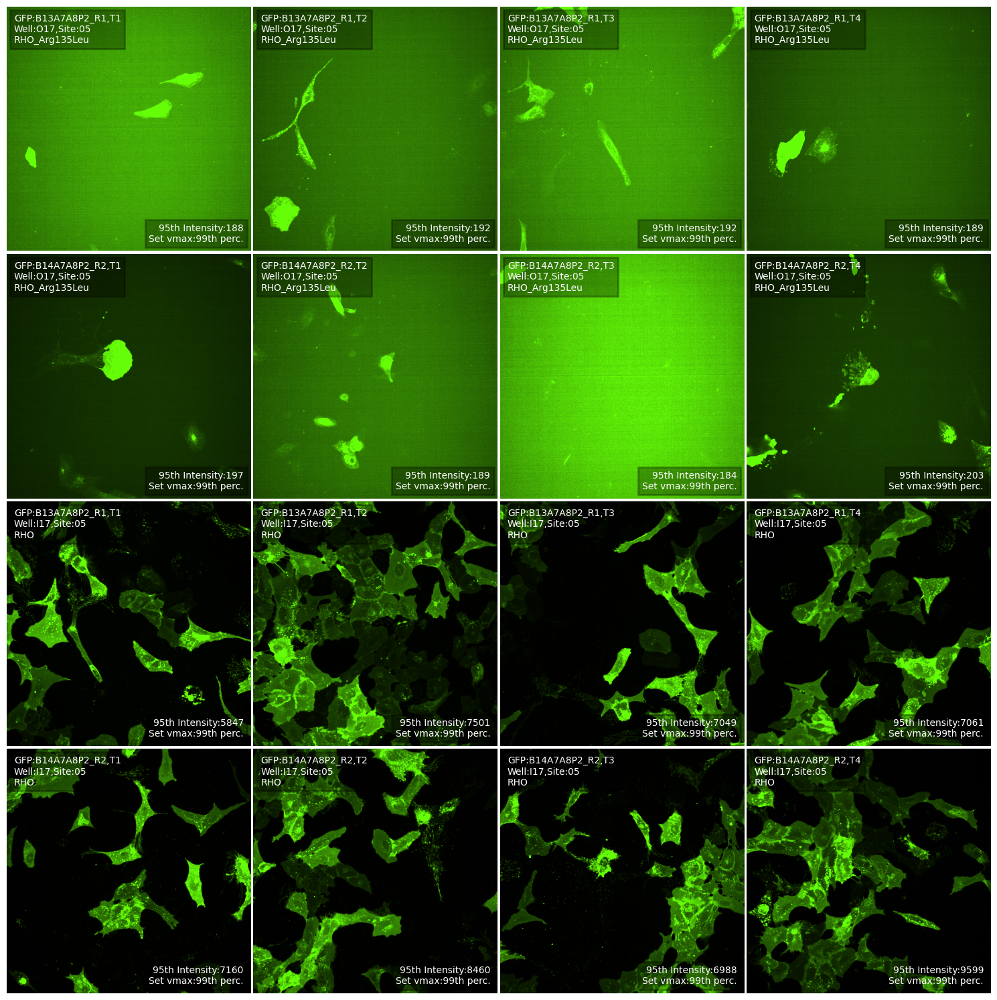

In [80]:
plot_allele(allele_meta_df.filter(pl.col("plate_map_name").str.contains("B13")), 
            "RHO_Arg135Leu", "GFP", plate_img_qc=img_well_qc_sum_gfp, site="05", max_intensity=0.99, display=True)

<Figure size 640x480 with 0 Axes>

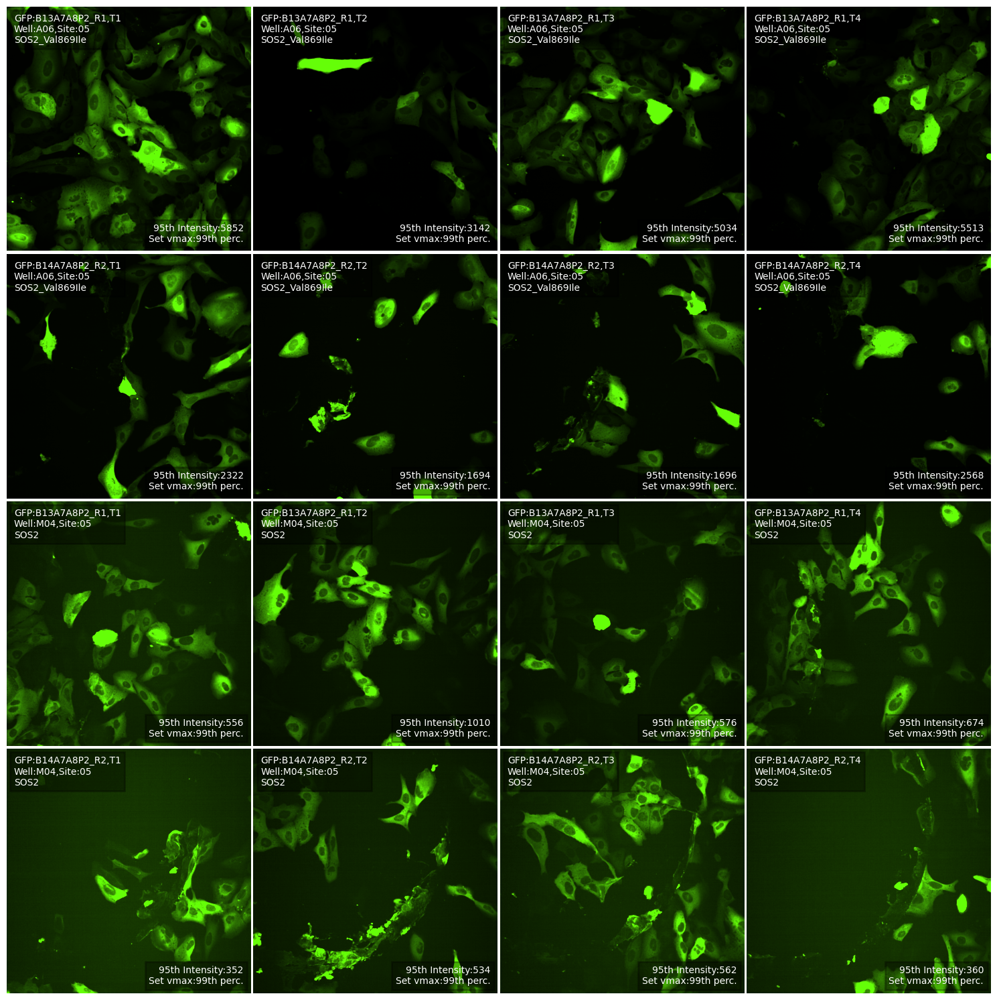

In [79]:
plot_allele(allele_meta_df.filter(pl.col("plate_map_name").str.contains("B13")), 
            "SOS2_Val869Ile", "GFP", plate_img_qc=img_well_qc_sum_gfp, site="05", max_intensity=0.99, display=True)

In [87]:
allele_meta_df.filter(pl.col("gene_allele")=="RAD51D_Glu233Gly")
allele_meta_df.filter(pl.col("gene_allele")=="RAD51D")

plate_map_name,well_position,symbol,gene_allele,imaging_well,imaging_plate_R1,imaging_plate_R2,node_type,orf_id_wt,ccsb_mutation_id,nt_change_cdna,aa_change,allele_set,imaging_plate,batch1,batch2,clone_ID,hgmd_ID,clinvar_allele_ID,clinvar_clinical_significance,vector,notes,plate,quad,c96,r96,r384,c384,r384_letter,orf_id,symbol_right,nt_change,aa_change_right,ensembl_gene_id,chr,chr_pos_38,spdi,…,RS# (dbSNP)_dbnsfp,nsv/esv (dbVar)_dbnsfp,RCVaccession_dbnsfp,PhenotypeIDS_dbnsfp,PhenotypeList_dbnsfp,Origin_dbnsfp,OriginSimple_dbnsfp,Assembly_dbnsfp,ChromosomeAccession_dbnsfp,Chromosome_dbnsfp,Start_dbnsfp,Stop_dbnsfp,Cytogenetic_dbnsfp,ReviewStatus_dbnsfp,NumberSubmitters_dbnsfp,Guidelines_dbnsfp,TestedInGTR_dbnsfp,OtherIDs_dbnsfp,SubmitterCategories_dbnsfp,VariationID_dbnsfp,PositionVCF_dbnsfp,ReferenceAlleleVCF_dbnsfp,AlternateAlleleVCF_dbnsfp,SomaticClinicalImpact_dbnsfp,SomaticClinicalImpactLastEvaluated_dbnsfp,ReviewStatusClinicalImpact_dbnsfp,Oncogenicity_dbnsfp,OncogenicityLastEvaluated_dbnsfp,ReviewStatusOncogenicity_dbnsfp,SCVsForAggregateGermlineClassification_dbnsfp,SCVsForAggregateSomaticClinicalImpact_dbnsfp,SCVsForAggregateOncogenicityClassification_dbnsfp,clinvar_nt_change_dbnsfp,clinvar_aa_change_dbnsfp,RefSeq_mRNA_dbnsfp,StarStatus_dbnsfp,clinvar_clnsig_clean_dbnsfp
str,str,str,str,str,str,str,str,f64,str,str,str,f64,f64,f64,f64,str,str,str,str,f64,str,i64,i64,i64,i64,i64,i64,str,i64,str,str,str,str,str,i64,str,…,i64,str,str,str,str,str,str,str,str,str,i64,i64,str,str,i64,str,str,str,i64,i64,i64,str,str,str,str,str,str,str,str,str,str,str,str,str,str,i64,str
"""B13A7A8P1_R1""","""F24""","""RAD51D""","""RAD51D""","""F24""","""B13A7A8P1_R1""","""B14A7A8P1_R2""","""disease_wt""",7201.0,null,null,null,7.0,1.0,13.0,14.0,null,null,null,null,527.0,null,1,4,12,3,6,24,"""F""",null,null,null,null,null,null,null,null,…,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null
"""B13A7A8P2_R1""","""A01""","""RAD51D""","""RAD51D""","""A01""","""B13A7A8P2_R1""","""B14A7A8P2_R2""","""disease_wt""",7201.0,null,null,null,7.0,2.0,13.0,14.0,null,null,null,null,527.0,null,2,1,1,1,1,1,"""A""",null,null,null,null,null,null,null,null,…,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null,null


<Figure size 640x480 with 0 Axes>

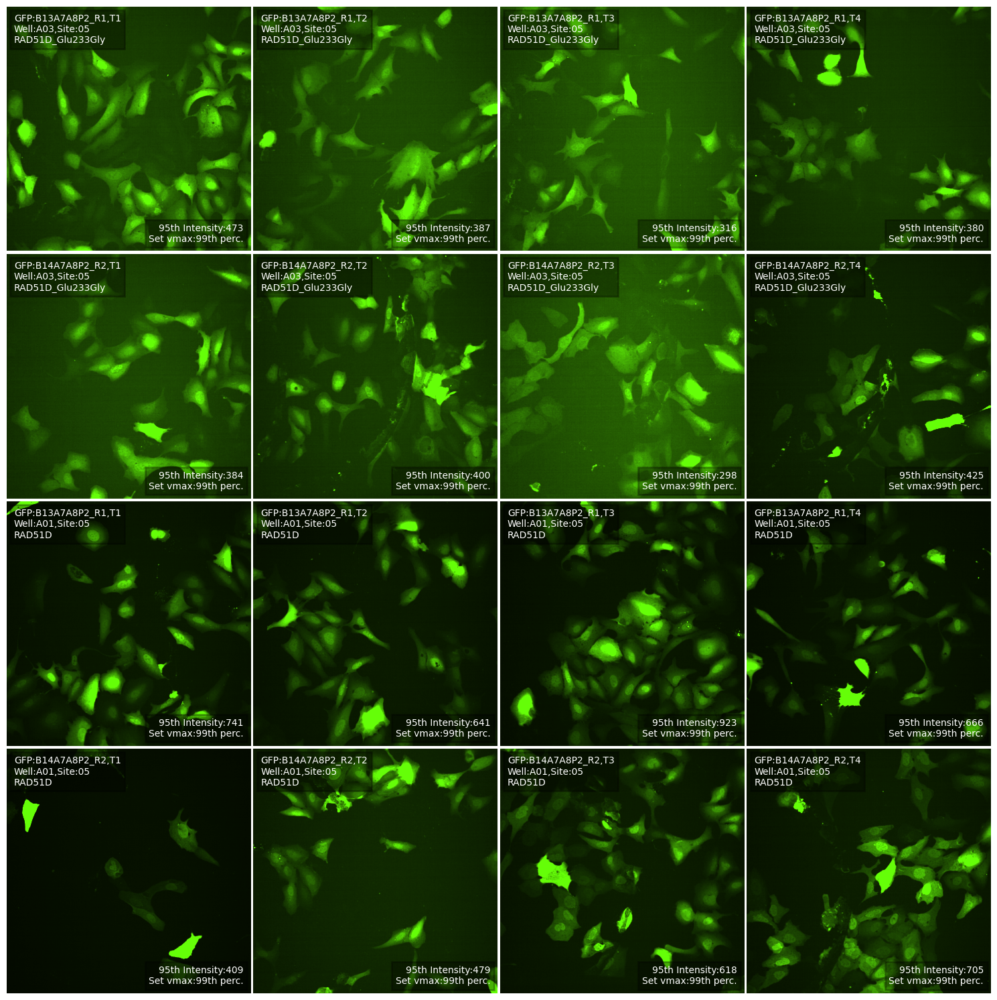

In [88]:
plot_allele(allele_meta_df.filter(pl.col("plate_map_name").str.contains("B13")), 
            "RAD51D_Glu233Gly", "GFP", ref_well=["A01"], plate_img_qc=img_well_qc_sum_gfp, site="05", max_intensity=0.99, display=True)